In [1]:
import folium
import geopandas as gpd 
import json
import matplotlib.pyplot as plt 
import pandas as pd 
import seaborn as sns

from folium import plugins 
from shapely.geometry import Point

from src.config import CLEAN_DATA, REAL_GEO_DATA, GEO_DATA_MEDIAN
from src.plots import SCATTER_ALPHA, PALETTE

sns.set_theme(palette='bright', style="white")

In [2]:
df = pd.read_parquet(CLEAN_DATA)

df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,median_income_cat,population_per_household,rooms_per_household,bedrooms_per_household,bedrooms_per_room
0,-122.230003,37.880001,41,880,129,322,126,8.3252,452600,NEAR BAY,6+,2.555556,6.984127,1.023810,0.146591
1,-122.220001,37.860001,21,7099,1106,2401,1138,8.3014,358500,NEAR BAY,6+,2.109842,6.238137,0.971880,0.155797
2,-122.260002,37.840000,42,2555,665,1206,595,2.0804,226700,NEAR BAY,1.5,2.026891,4.294117,1.117647,0.260274
3,-122.260002,37.849998,50,1120,283,697,264,2.1250,140000,NEAR BAY,1.5,2.640152,4.242424,1.071970,0.252679
4,-122.260002,37.840000,50,2239,455,990,419,1.9911,158700,NEAR BAY,1.5,2.362768,5.343676,1.085919,0.203216


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17540 entries, 0 to 17539
Data columns (total 15 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   longitude                 17540 non-null  float32 
 1   latitude                  17540 non-null  float32 
 2   housing_median_age        17540 non-null  int8    
 3   total_rooms               17540 non-null  int16   
 4   total_bedrooms            17540 non-null  int16   
 5   population                17540 non-null  int16   
 6   households                17540 non-null  int16   
 7   median_income             17540 non-null  float32 
 8   median_house_value        17540 non-null  int32   
 9   ocean_proximity           17540 non-null  category
 10  median_income_cat         17540 non-null  category
 11  population_per_household  17540 non-null  float32 
 12  rooms_per_household       17540 non-null  float32 
 13  bedrooms_per_household    17540 non-null  floa

In [4]:
# fonte: https://data.ca.gov/dataset/california-counties/resource/3ad38f4f-d7f2-43b9-802a-cfc2ddae161d
gdf_counties = gpd.read_file(REAL_GEO_DATA)

gdf_counties.head()

,OBJECTID,Year,CountyName,COUNTY_FIPS,DistrictCount,geometry
0,117,2023,Alameda,001,22,"MULTIPOLYGON (((-13577345.444 4504491.196, -13..."
1,118,2023,Alpine,003,2,"POLYGON ((-13312191.387 4680675.259, -13312135..."
2,119,2023,Amador,005,2,"POLYGON ((-13366398.979 4679185.227, -13366398..."
3,120,2023,Colusa,011,5,"POLYGON ((-13568735.664 4776807.645, -13568728..."
4,121,2023,El Dorado,017,16,"POLYGON ((-13347688.733 4712126.051, -13347699..."


<Axes: >

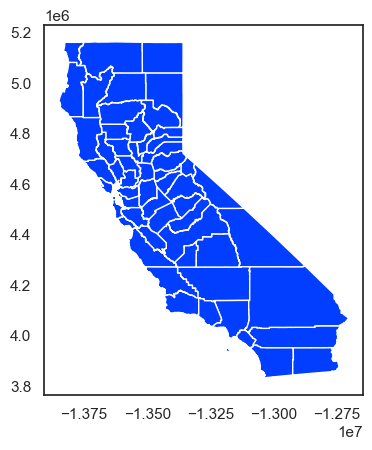

In [5]:
gdf_counties.plot(legend=True)

### Transformando Latitude e Longetude em Points

In [6]:
points = [Point(long, lat) for long, lat in zip(df['longitude'], df['latitude'])]

points[:5]

[<POINT (-122.23 37.88)>,
 <POINT (-122.22 37.86)>,
 <POINT (-122.26 37.84)>,
 <POINT (-122.26 37.85)>,
 <POINT (-122.26 37.84)>]

In [7]:
gdf = gpd.GeoDataFrame(df, crs="EPSG:4326", geometry=points)

gdf.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,median_income_cat,population_per_household,rooms_per_household,bedrooms_per_household,bedrooms_per_room,geometry
0,-122.230003,37.880001,41,880,129,322,126,8.3252,452600,NEAR BAY,6+,2.555556,6.984127,1.023810,0.146591,POINT (-122.23 37.88)
1,-122.220001,37.860001,21,7099,1106,2401,1138,8.3014,358500,NEAR BAY,6+,2.109842,6.238137,0.971880,0.155797,POINT (-122.22 37.86)
2,-122.260002,37.840000,42,2555,665,1206,595,2.0804,226700,NEAR BAY,1.5,2.026891,4.294117,1.117647,0.260274,POINT (-122.26 37.84)
3,-122.260002,37.849998,50,1120,283,697,264,2.1250,140000,NEAR BAY,1.5,2.640152,4.242424,1.071970,0.252679,POINT (-122.26 37.85)
4,-122.260002,37.840000,50,2239,455,990,419,1.9911,158700,NEAR BAY,1.5,2.362768,5.343676,1.085919,0.203216,POINT (-122.26 37.84)


In [8]:
gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 17540 entries, 0 to 17539
Data columns (total 16 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   longitude                 17540 non-null  float32 
 1   latitude                  17540 non-null  float32 
 2   housing_median_age        17540 non-null  int8    
 3   total_rooms               17540 non-null  int16   
 4   total_bedrooms            17540 non-null  int16   
 5   population                17540 non-null  int16   
 6   households                17540 non-null  int16   
 7   median_income             17540 non-null  float32 
 8   median_house_value        17540 non-null  int32   
 9   ocean_proximity           17540 non-null  category
 10  median_income_cat         17540 non-null  category
 11  population_per_household  17540 non-null  float32 
 12  rooms_per_household       17540 non-null  float32 
 13  bedrooms_per_household    17540 non-nu

### verificando CRS

In [9]:
gdf_counties.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [10]:
gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

vamos transformar o counties em EPSG:4326 para conectar com os points

In [11]:
gdf_counties = gdf_counties.to_crs(epsg=4326)

gdf_counties.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### Merging regiões

In [12]:
gdf_joined = gpd.sjoin(gdf, gdf_counties, how="left", predicate="within")

gdf_joined.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,...,rooms_per_household,bedrooms_per_household,bedrooms_per_room,geometry,index_right,OBJECTID,Year,CountyName,COUNTY_FIPS,DistrictCount
0,-122.230003,37.880001,41,880,129,322,126,8.3252,452600,NEAR BAY,...,6.984127,1.023810,0.146591,POINT (-122.23 37.88),0.0,117.0,2023,Alameda,001,22.0
1,-122.220001,37.860001,21,7099,1106,2401,1138,8.3014,358500,NEAR BAY,...,6.238137,0.971880,0.155797,POINT (-122.22 37.86),0.0,117.0,2023,Alameda,001,22.0
2,-122.260002,37.840000,42,2555,665,1206,595,2.0804,226700,NEAR BAY,...,4.294117,1.117647,0.260274,POINT (-122.26 37.84),0.0,117.0,2023,Alameda,001,22.0
3,-122.260002,37.849998,50,1120,283,697,264,2.1250,140000,NEAR BAY,...,4.242424,1.071970,0.252679,POINT (-122.26 37.85),0.0,117.0,2023,Alameda,001,22.0
4,-122.260002,37.840000,50,2239,455,990,419,1.9911,158700,NEAR BAY,...,5.343676,1.085919,0.203216,POINT (-122.26 37.84),0.0,117.0,2023,Alameda,001,22.0


In [13]:
gdf_joined = gdf_joined.drop(
    columns=['index_right', 'OBJECTID', 'Year', 'COUNTY_FIPS', 'DistrictCount']
)

In [14]:
gdf_joined.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 17540 entries, 0 to 17539
Data columns (total 17 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   longitude                 17540 non-null  float32 
 1   latitude                  17540 non-null  float32 
 2   housing_median_age        17540 non-null  int8    
 3   total_rooms               17540 non-null  int16   
 4   total_bedrooms            17540 non-null  int16   
 5   population                17540 non-null  int16   
 6   households                17540 non-null  int16   
 7   median_income             17540 non-null  float32 
 8   median_house_value        17540 non-null  int32   
 9   ocean_proximity           17540 non-null  category
 10  median_income_cat         17540 non-null  category
 11  population_per_household  17540 non-null  float32 
 12  rooms_per_household       17540 non-null  float32 
 13  bedrooms_per_household    17540 non-null  f

### Verificando vazios

In [15]:
gdf_joined['CountyName'].isnull().sum()

np.int64(169)

In [16]:
gdf_joined[gdf_joined['CountyName'].isnull()]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,median_income_cat,population_per_household,rooms_per_household,bedrooms_per_household,bedrooms_per_room,geometry,CountyName
45,-122.269997,37.790001,27,1055,347,718,302,2.6354,187500,NEAR BAY,1.5,2.377483,3.493377,1.149007,0.328910,POINT (-122.27 37.79),NaN
265,-122.330002,37.889999,42,1342,291,551,266,4.5268,207400,NEAR BAY,4.5,2.071429,5.045113,1.093985,0.216841,POINT (-122.33 37.89),NaN
266,-122.339996,37.880001,37,3061,930,2556,924,1.7375,350000,NEAR BAY,1.5,2.766234,3.312771,1.006493,0.303822,POINT (-122.34 37.88),NaN
308,-122.290001,37.759998,18,2873,763,1243,663,5.1702,265400,NEAR BAY,4.5,1.874811,4.333333,1.150830,0.265576,POINT (-122.29 37.76),NaN
312,-122.230003,37.750000,50,1542,289,654,268,3.9632,240000,NEAR BAY,3,2.440299,5.753731,1.078358,0.187419,POINT (-122.23 37.75),NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17174,-119.300003,34.270000,17,1527,503,688,423,1.6007,187500,NEAR OCEAN,1.5,1.626478,3.609929,1.189125,0.329404,POINT (-119.3 34.27),NaN
17175,-119.290001,34.259998,32,3295,764,1344,600,3.6007,395500,NEAR OCEAN,3,2.240000,5.491667,1.273333,0.231866,POINT (-119.29 34.26),NaN
17177,-119.290001,34.230000,22,2486,608,709,523,2.9018,275000,NEAR OCEAN,1.5,1.355641,4.753346,1.162524,0.244570,POINT (-119.29 34.23),NaN
17208,-119.230003,34.150002,18,6213,1188,2679,1000,3.7480,380400,NEAR OCEAN,3,2.679000,6.213000,1.188000,0.191212,POINT (-119.23 34.15),NaN


In [17]:
gdf_missing_index = gdf_joined[gdf_joined['CountyName'].isnull()].index

gdf_missing_index

Index([   45,   265,   266,   308,   312,   313,   317,   318,   320,   412,
       ...
       15728, 15732, 15735, 15921, 15951, 17174, 17175, 17177, 17208, 17234],
      dtype='int64', length=169)

como não sabemos o sistema de coordenada usado, alguns pontos não foram encontrados no mapa em que utilizamos. para isso, vamos corrigir esses pontos pegando o condado mais próximo

### Corrigindo pontos faltantes

In [18]:
gdf_counties['centroid'] = gdf_counties.centroid

/var/folders/hh/7zqx20m57csf29d4y06lnk7r0000gn/T/ipykernel_1511/3769767495.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_counties['centroid'] = gdf_counties.centroid


In [19]:
for i in gdf_missing_index:
    point = gdf.loc[i,'geometry']
    # pegando o index da menor distancia entre centroid e ponto
    county_index = gdf_counties['centroid'].distance(point).idxmin()
    # map do index para encontrar condado
    county = gdf_counties.loc[county_index, 'CountyName']
    # atualizando no gdf_joined
    gdf_joined.loc[i, 'CountyName'] = county

/var/folders/hh/7zqx20m57csf29d4y06lnk7r0000gn/T/ipykernel_1511/3019273501.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'distance' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  county_index = gdf_counties['centroid'].distance(point).idxmin()
/var/folders/hh/7zqx20m57csf29d4y06lnk7r0000gn/T/ipykernel_1511/3019273501.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'distance' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  county_index = gdf_counties['centroid'].distance(point).idxmin()
/var/folders/hh/7zqx20m57csf29d4y06lnk7r0000gn/T/ipykernel_1511/3019273501.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'distance' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  county_index = gdf_counties['centroid'].distance(point).idxmin()
/

In [20]:
gdf_joined.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 17540 entries, 0 to 17539
Data columns (total 17 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   longitude                 17540 non-null  float32 
 1   latitude                  17540 non-null  float32 
 2   housing_median_age        17540 non-null  int8    
 3   total_rooms               17540 non-null  int16   
 4   total_bedrooms            17540 non-null  int16   
 5   population                17540 non-null  int16   
 6   households                17540 non-null  int16   
 7   median_income             17540 non-null  float32 
 8   median_house_value        17540 non-null  int32   
 9   ocean_proximity           17540 non-null  category
 10  median_income_cat         17540 non-null  category
 11  population_per_household  17540 non-null  float32 
 12  rooms_per_household       17540 non-null  float32 
 13  bedrooms_per_household    17540 non-null  f

In [21]:
gdf_joined.loc[gdf_missing_index, 'CountyName'].value_counts()

CountyName
San Francisco      39
Orange             21
Santa Cruz         21
San Diego          21
Santa Barbara      13
San Luis Obispo    10
Ventura             8
Los Angeles         6
Del Norte           5
Humboldt            5
Mendocino           5
San Mateo           5
Monterey            4
Marin               3
Contra Costa        2
Alpine              1
Name: count, dtype: int64

### Criando mapas

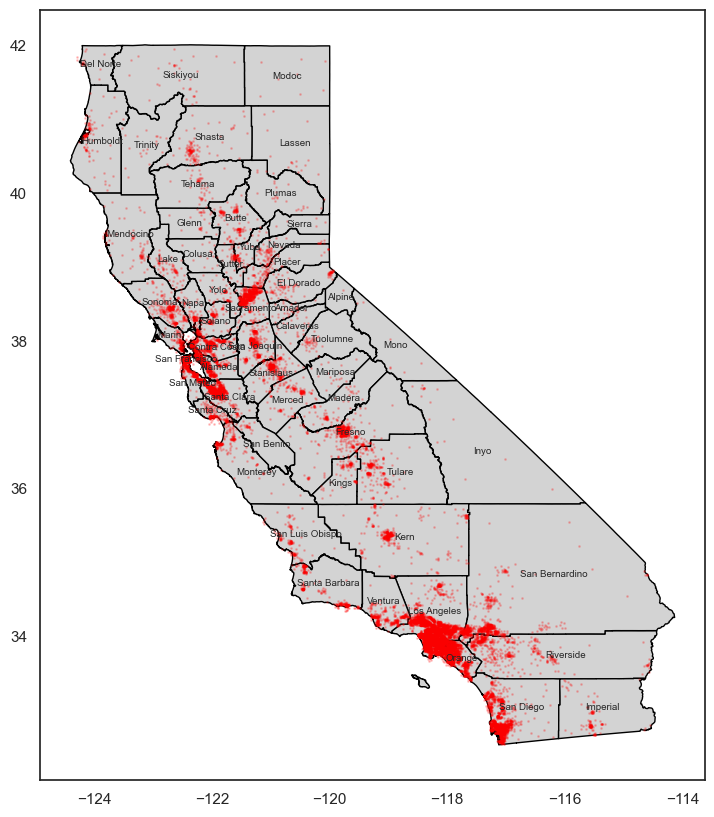

In [22]:
fig, ax = plt.subplots(figsize=(10, 10))

gdf_counties.plot(
    ax=ax,
    edgecolor='black',
    color='lightgrey'
)

plt.scatter(
    x=gdf_joined['longitude'],
    y=gdf_joined['latitude'],
    color='red',
    s=1,
    alpha=SCATTER_ALPHA
)

for x, y, countyName in zip(gdf_counties['centroid'].x, gdf_counties['centroid'].y, gdf_counties['CountyName']):
    ax.text(x, y, countyName, fontsize=7, ha='center', va='center')

#### Tratamento dos campos para os próximos mapas

In [23]:
gdf_joined.groupby('CountyName', as_index=False).mean(numeric_only=True)

,CountyName,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,population_per_household,rooms_per_household,bedrooms_per_household,bedrooms_per_room
0,Alameda,-122.112907,37.708923,32.932414,2391.484138,491.314483,1260.424828,467.384828,3.789547,196717.517241,2.756036,5.184725,1.051288,0.211672
1,Alpine,-119.860001,38.824997,18.500000,1407.500000,334.000000,402.500000,203.500000,2.001800,165050.000000,2.027528,7.331940,1.684494,0.236384
2,Amador,-120.716301,38.420368,19.444444,2385.296296,462.666667,929.962963,378.925926,3.062196,116970.370370,2.468820,6.340945,1.234367,0.194895
3,Butte,-121.646187,39.631042,23.722222,2407.923611,485.243056,1162.298611,457.388889,2.353120,88297.222222,2.574998,5.322340,1.069910,0.203286
4,Calaveras,-120.594002,38.208797,17.520000,2842.640000,570.960000,1145.280000,451.120000,2.667160,106032.000000,2.524048,6.140102,1.263452,0.206328
5,Colusa,-122.099998,39.174286,32.214286,2060.857143,418.928571,1083.571429,369.357143,2.555907,75385.714286,2.893713,5.867276,1.205223,0.206268
6,Contra Costa,-122.086998,37.943642,26.836957,2843.143116,518.184783,1315.032609,493.282609,4.519208,209220.108696,2.724034,5.783221,1.045321,0.188683
7,Del Norte,-124.137505,41.753124,19.312500,2609.125000,543.875000,1276.000000,474.875000,2.399369,89768.750000,2.682152,5.566829,1.159943,0.209308
8,El Dorado,-120.547195,38.788101,17.390000,2711.660000,517.220000,1168.490000,436.710000,3.313168,138381.000000,2.660043,6.309325,1.250898,0.200645
9,Fresno,-119.771362,36.728107,24.981670,2202.617108,442.179226,1266.297352,418.796334,2.940400,85052.138493,3.102595,5.318804,1.051340,0.203917


In [24]:
gdf_counties = gdf_counties.merge(
    gdf_joined.groupby('CountyName').mean(numeric_only=True), 
    on='CountyName'
)

gdf_counties.head()

,OBJECTID,Year,CountyName,COUNTY_FIPS,DistrictCount,geometry,centroid,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,population_per_household,rooms_per_household,bedrooms_per_household,bedrooms_per_room
0,117,2023,Alameda,001,22,"MULTIPOLYGON (((-121.96737 37.46764, -121.9683...",POINT (-121.8862 37.64651),-122.112907,37.708923,32.932414,2391.484138,491.314483,1260.424828,467.384828,3.789547,196717.517241,2.756036,5.184725,1.051288,0.211672
1,118,2023,Alpine,003,2,"POLYGON ((-119.58545 38.71322, -119.58494 38.7...",POINT (-119.82067 38.59726),-119.860001,38.824997,18.500000,1407.500000,334.000000,402.500000,203.500000,2.001800,165050.000000,2.027528,7.331940,1.684494,0.236384
2,119,2023,Amador,005,2,"POLYGON ((-120.0724 38.70277, -120.0724 38.702...",POINT (-120.65113 38.44639),-120.716301,38.420368,19.444444,2385.296296,462.666667,929.962963,378.925926,3.062196,116970.370370,2.468820,6.340945,1.234367,0.194895
3,120,2023,Colusa,011,5,"POLYGON ((-121.89003 39.38387, -121.88996 39.3...",POINT (-122.23704 39.17758),-122.099998,39.174286,32.214286,2060.857143,418.928571,1083.571429,369.357143,2.555907,75385.714286,2.893713,5.867276,1.205223,0.206268
4,121,2023,El Dorado,017,16,"POLYGON ((-119.90433 38.93333, -119.90442 38.9...",POINT (-120.52466 38.77874),-120.547195,38.788101,17.390000,2711.660000,517.220000,1168.490000,436.710000,3.313168,138381.000000,2.660043,6.309325,1.250898,0.200645


In [25]:
gdf_joined[['CountyName', 'ocean_proximity']].groupby('CountyName', as_index=False).agg(pd.Series.mode)

,CountyName,ocean_proximity
0,Alameda,NEAR BAY
1,Alpine,INLAND
2,Amador,INLAND
3,Butte,INLAND
4,Calaveras,INLAND
5,Colusa,INLAND
6,Contra Costa,NEAR BAY
7,Del Norte,NEAR OCEAN
8,El Dorado,INLAND
9,Fresno,INLAND


In [26]:
gdf_counties = gdf_counties.merge(
    gdf_joined[['CountyName', 'ocean_proximity']].groupby('CountyName', as_index=False).agg(pd.Series.mode),
    on='CountyName'
)

gdf_counties.head()

,OBJECTID,Year,CountyName,COUNTY_FIPS,DistrictCount,geometry,centroid,longitude,latitude,housing_median_age,...,total_bedrooms,population,households,median_income,median_house_value,population_per_household,rooms_per_household,bedrooms_per_household,bedrooms_per_room,ocean_proximity
0,117,2023,Alameda,001,22,"MULTIPOLYGON (((-121.96737 37.46764, -121.9683...",POINT (-121.8862 37.64651),-122.112907,37.708923,32.932414,...,491.314483,1260.424828,467.384828,3.789547,196717.517241,2.756036,5.184725,1.051288,0.211672,NEAR BAY
1,118,2023,Alpine,003,2,"POLYGON ((-119.58545 38.71322, -119.58494 38.7...",POINT (-119.82067 38.59726),-119.860001,38.824997,18.500000,...,334.000000,402.500000,203.500000,2.001800,165050.000000,2.027528,7.331940,1.684494,0.236384,INLAND
2,119,2023,Amador,005,2,"POLYGON ((-120.0724 38.70277, -120.0724 38.702...",POINT (-120.65113 38.44639),-120.716301,38.420368,19.444444,...,462.666667,929.962963,378.925926,3.062196,116970.370370,2.468820,6.340945,1.234367,0.194895,INLAND
3,120,2023,Colusa,011,5,"POLYGON ((-121.89003 39.38387, -121.88996 39.3...",POINT (-122.23704 39.17758),-122.099998,39.174286,32.214286,...,418.928571,1083.571429,369.357143,2.555907,75385.714286,2.893713,5.867276,1.205223,0.206268,INLAND
4,121,2023,El Dorado,017,16,"POLYGON ((-119.90433 38.93333, -119.90442 38.9...",POINT (-120.52466 38.77874),-120.547195,38.788101,17.390000,...,517.220000,1168.490000,436.710000,3.313168,138381.000000,2.660043,6.309325,1.250898,0.200645,INLAND


#### Criando mapas

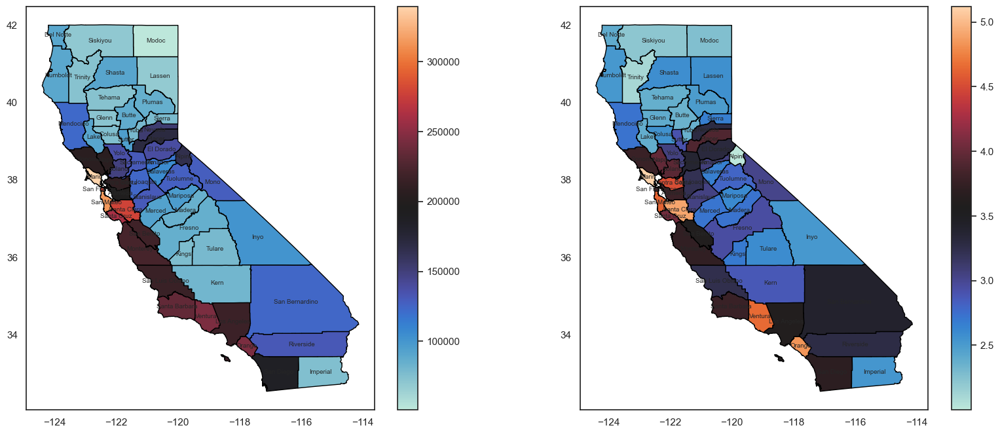

In [27]:
fig, axs = plt.subplots(1, 2, figsize=(20, 8))

gdf_counties.plot(
    ax=axs[0],
    edgecolor='black',
    column='median_house_value',
    cmap=PALETTE,
    legend=True
)

gdf_counties.plot(
    ax=axs[1],
    edgecolor='black',
    column='median_income',
    cmap=PALETTE,
    legend=True
)

for x, y, countyName in zip(gdf_counties['centroid'].x, gdf_counties['centroid'].y, gdf_counties['CountyName']):
    axs[0].text(x, y, countyName, fontsize=7, ha='center', va='center')
    axs[1].text(x, y, countyName, fontsize=7, ha='center', va='center')

### Exportando df com médias

In [28]:
gdf_counties.to_parquet(GEO_DATA_MEDIAN)

### Mapa interativo com o Folium

In [29]:
map_center = [gdf_counties['latitude'].mean(), gdf_counties['longitude'].mean()]

In [30]:
height_width_map = {'height': 500,'width': 500}

fig = folium.Figure(**height_width_map)

# criando estrutura do mapa dinâmico
maps = folium.Map(
    map_center, 
    zoom_start=5, 
    tiles="cartodb positron"
).add_to(fig)

# adicionando edges dos conties no mapa a partir do GeoJson
folium.GeoJson(
    gdf_counties[['CountyName', 'geometry']],
    tooltip=folium.GeoJsonTooltip(fields=['CountyName'])
).add_to(maps)

# Adicionando controle de layer
folium.LayerControl().add_to(maps)

# Plugin para pegar localização do mouse
plugins.MousePosition().add_to(maps)

maps

In [31]:
with open(REAL_GEO_DATA, 'r') as file:
    geojson = json.load(file)

In [32]:
fig = folium.Figure(**height_width_map)

# criando estrutura do mapa dinâmico
maps = folium.Map(
    map_center, 
    zoom_start=5, 
    tiles="cartodb positron"
).add_to(fig)

folium.Choropleth(
    geo_data=gdf_counties[["CountyName", 'geometry', "median_income"]],
    data=gdf_counties[["CountyName", 'geometry', "median_income"]],
    columns=["CountyName", "median_income"],
    key_on="feature.properties.CountyName",
    fill_color="YlOrRd",
    legend_name='median_income',
    fill_opacity=0.7,
    line_opacity=0.3
).add_to(maps)

# Adicionando controle de layer
folium.LayerControl().add_to(maps)

# Plugin para pegar localização do mouse
plugins.MousePosition().add_to(maps)

maps